In [ ]:
# Install necessary libraries
!pip install shap lime xgboost

# Import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, KFold
from sklearn.feature_selection import RFE
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor, BaggingRegressor, StackingRegressor
from sklearn.svm import SVR
from sklearn.linear_model import Ridge, Lasso, LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import shap
import lime
import lime.lime_tabular
import xgboost as xgb
from google.colab import drive


drive.mount('/content/drive')
file_path = '/content/drive/My Drive/datasets/dataset2.csv'
df_sector = pd.read_csv(file_path)

# Select only the necessary columns for analysis
df_sector = df_sector[['sector', 'Forward P/E', 'Market Cap', 'Enterprise Value',
                       'Float Shares', 'Shares Outstanding', 'Shares Short', 'Shares Short Prior Month',
                       'Shares Percent Shares Out', 'Held Percent Insiders', 'Held Percent Institutions',
                       'Short Ratio', 'Short Percent of Float', 'Beta', 'Book Value', 'Price to Book',
                       'Last Fiscal Year End', 'Next Fiscal Year End', 'Most Recent Quarter',
                       'Earnings Quarterly Growth', 'Net Income to Common', 'Trailing EPS',
                       'Forward EPS', 'PEG Ratio', 'Enterprise to Revenue', 'Enterprise to EBITDA',
                       'Current Price', 'Total Cash',
                       'Total Cash Per Share', 'EBITDA', 'Total Debt', 'Quick Ratio', 'Current Ratio',
                       'Total Revenue', 'Debt to Equity', 'Revenue Per Share', 'Return on Assets',
                       'Return on Equity', 'Free Cashflow', 'Operating Cashflow',
                       'Earnings Growth', 'Revenue Growth', 'Gross Margins', 'EBITDA Margins',
                       'Operating Margins', 'Profit Margins', 'total esg']]

from sklearn.impute import SimpleImputer

# Drop rows with missing values in 'sector' or 'total esg'
df_sector = df_sector.dropna(subset=['sector', 'total esg'])

unique_sectors = df_sector['sector'].unique()
df_sector['sector_encoded'] = df_sector['sector'].astype('category').cat.codes

#Create the mapping between encoded values and original sector names
sector_mapping = dict(enumerate(unique_sectors))
print("Sector Mapping:", sector_mapping)

df_sector['sector'] = df_sector['sector_encoded']
df_sector = df_sector.drop(columns=['sector_encoded'])

# Impute missing values in the entire dataframe using the mean strategy
imputer = SimpleImputer(strategy='mean')
df_sector_imputed = pd.DataFrame(imputer.fit_transform(df_sector), columns=df_sector.columns)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Sector Mapping: {0: 'Basic Materials', 1: 'Consumer Cyclical', 2: 'Healthcare', 3: 'Industrials', 4: 'Utilities', 5: 'Financial Services', 6: 'Energy', 7: 'Real Estate', 8: 'Technology', 9: 'Communication Services', 10: 'Consumer Defensive'}


In [ ]:
# Assuming df_sector has already been encoded and sector_mapping has been created

# Print the total number of sectors
total_sectors = len(sector_mapping)
print(f"Total number of sectors: {total_sectors}")

# Print the mapping of encoded sector values to original sector names
print("Sector encodings and their respective sector names:")
for encoded_value, original_sector in sector_mapping.items():
    print(f"Encoded Value: {encoded_value}, Sector Name: {original_sector}")


Total number of sectors: 11
Sector encodings and their respective sector names:
Encoded Value: 0, Sector Name: Basic Materials
Encoded Value: 1, Sector Name: Consumer Cyclical
Encoded Value: 2, Sector Name: Healthcare
Encoded Value: 3, Sector Name: Industrials
Encoded Value: 4, Sector Name: Utilities
Encoded Value: 5, Sector Name: Financial Services
Encoded Value: 6, Sector Name: Energy
Encoded Value: 7, Sector Name: Real Estate
Encoded Value: 8, Sector Name: Technology
Encoded Value: 9, Sector Name: Communication Services
Encoded Value: 10, Sector Name: Consumer Defensive


In [ ]:
# Define the models to be used in the analysis
models = {
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'GradientBoosting': GradientBoostingRegressor(),
    'XGBoost': xgb.XGBRegressor(),  # Corrected this line
    'SVM': SVR(),
    'RandomForest': RandomForestRegressor()
}

sectors = df_sector_imputed['sector'].unique()

sector_results = {}

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:239: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.799e+00, tolerance: 3.155e-02
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Basic Materials: Lasso with R² = 0.9235


  0%|          | 0/4 [00:00<?, ?it/s]


Lasso Model SHAP Analysis for Sector Basic Materials


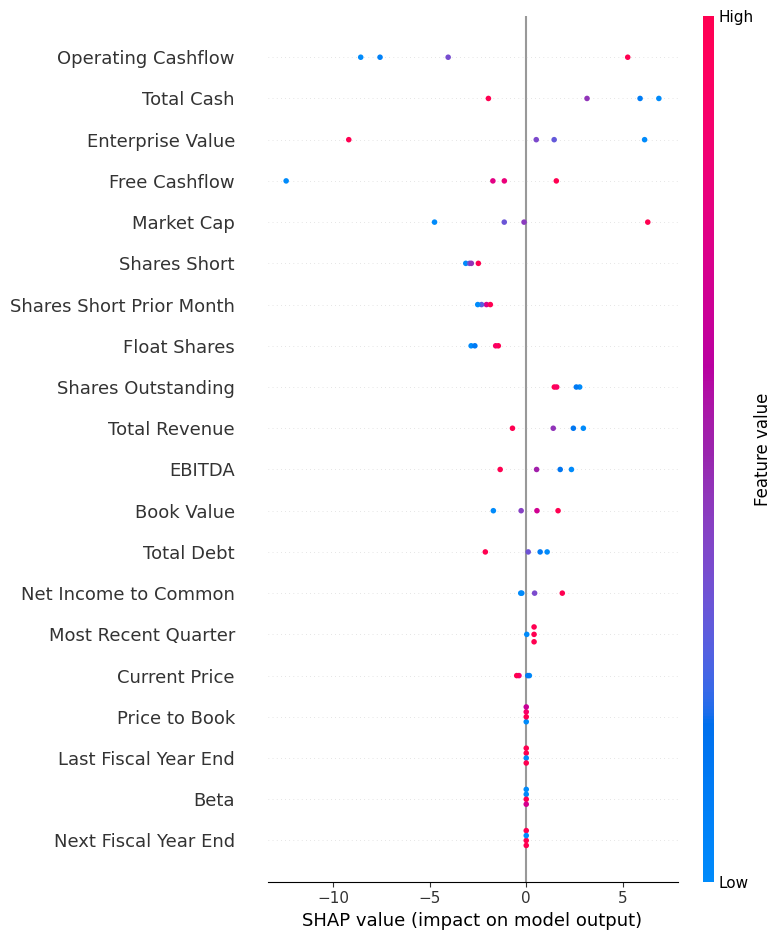


Lasso Model LIME Analysis for Sector Basic Materials


/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:239: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.159e+02, tolerance: 1.246e-01
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Healthcare: XGBoost with R² = 0.4379

XGBoost Model SHAP Analysis for Sector Healthcare


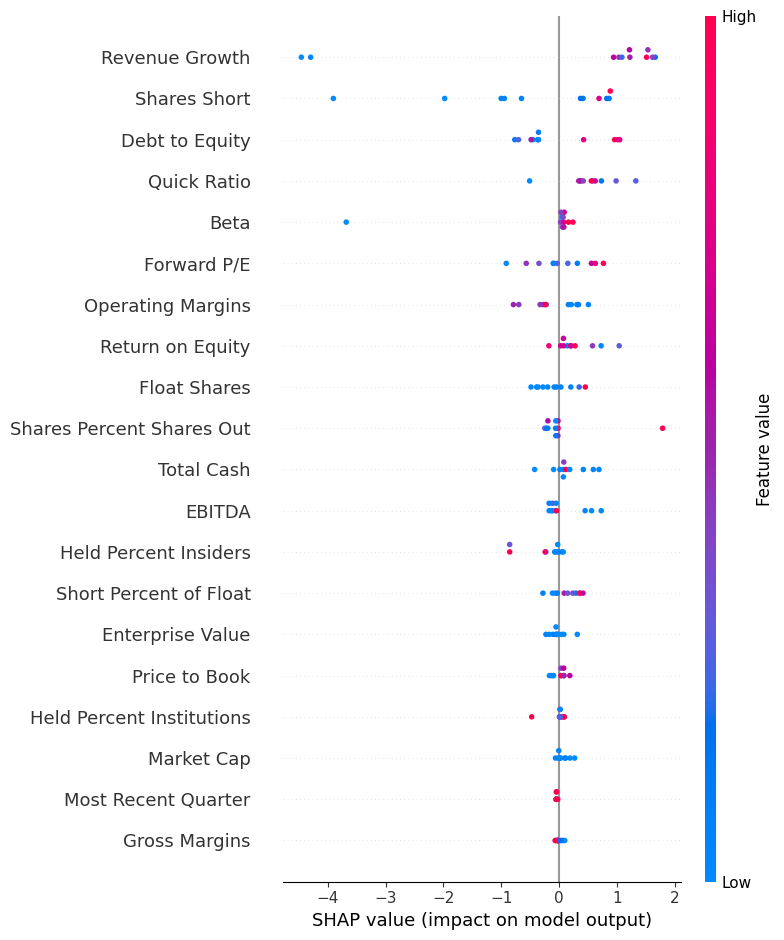

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


XGBoost Model LIME Analysis for Sector Healthcare


/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:427: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:239: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.133e+02, tolerance: 1.154e-01
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Energy: XGBoost with R² = 0.4186

XGBoost Model SHAP Analysis for Sector Energy


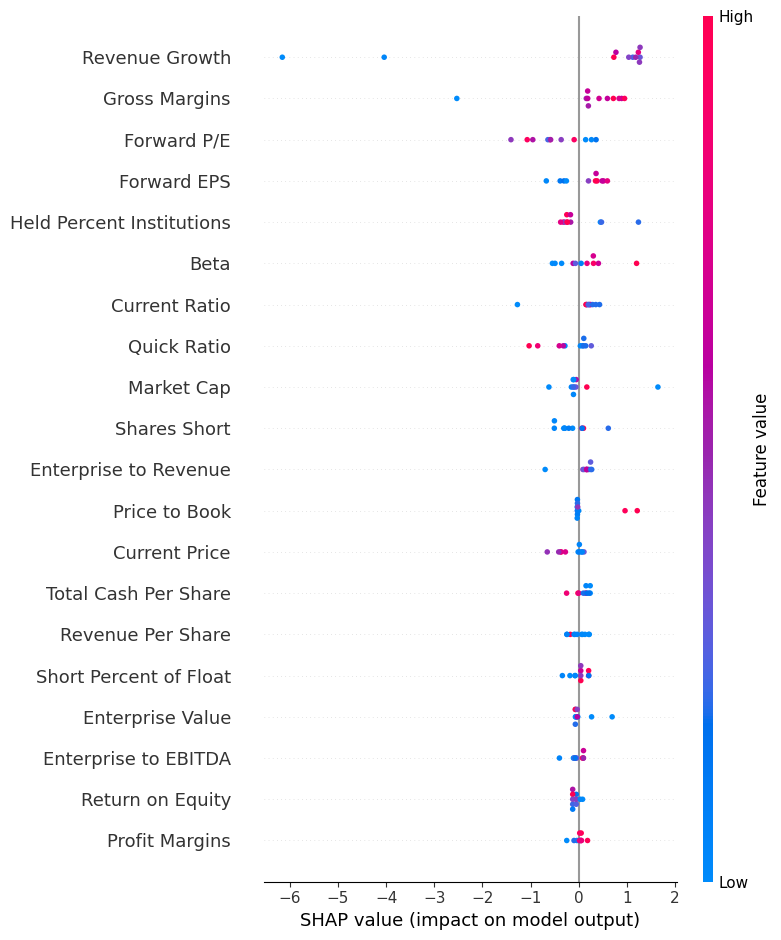

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


XGBoost Model LIME Analysis for Sector Energy


/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:427: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:200: LinAlgWarning: Ill-conditioned matrix (rcond=3.30932e-24): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.787e+02, tolerance: 2.471e-01
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Real Estate: SVM with R² = 0.0637


  0%|          | 0/12 [00:00<?, ?it/s]


SVM Model SHAP Analysis for Sector Real Estate


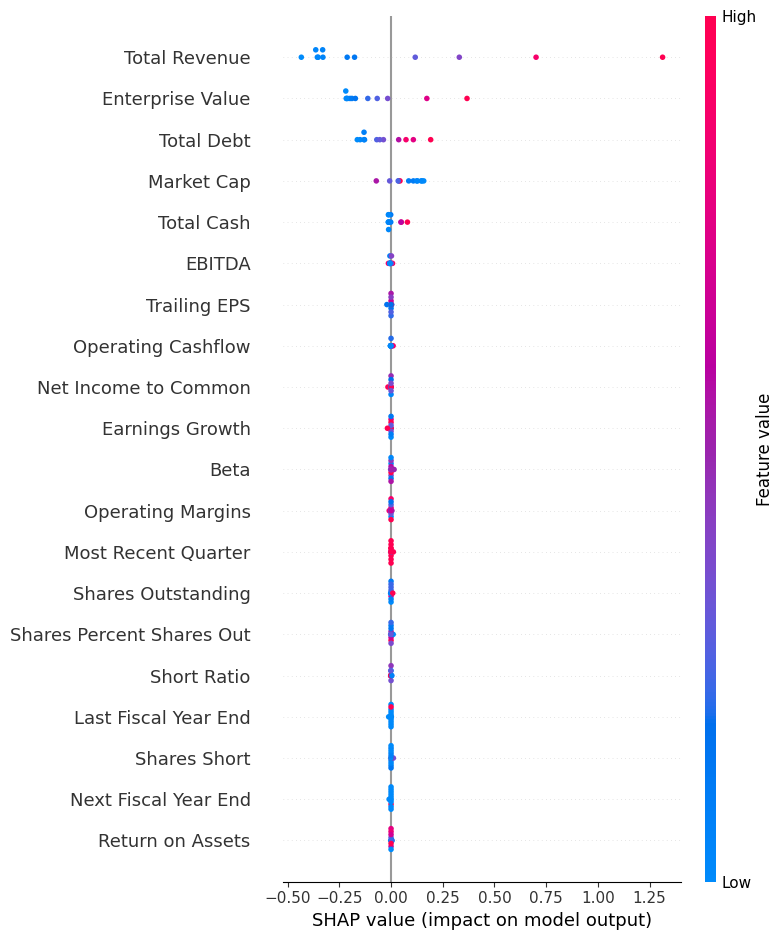

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


SVM Model LIME Analysis for Sector Real Estate


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:239: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.145e+01, tolerance: 3.497e-02
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Consumer Defensive: SVM with R² = 0.0743


  0%|          | 0/6 [00:00<?, ?it/s]


SVM Model SHAP Analysis for Sector Consumer Defensive


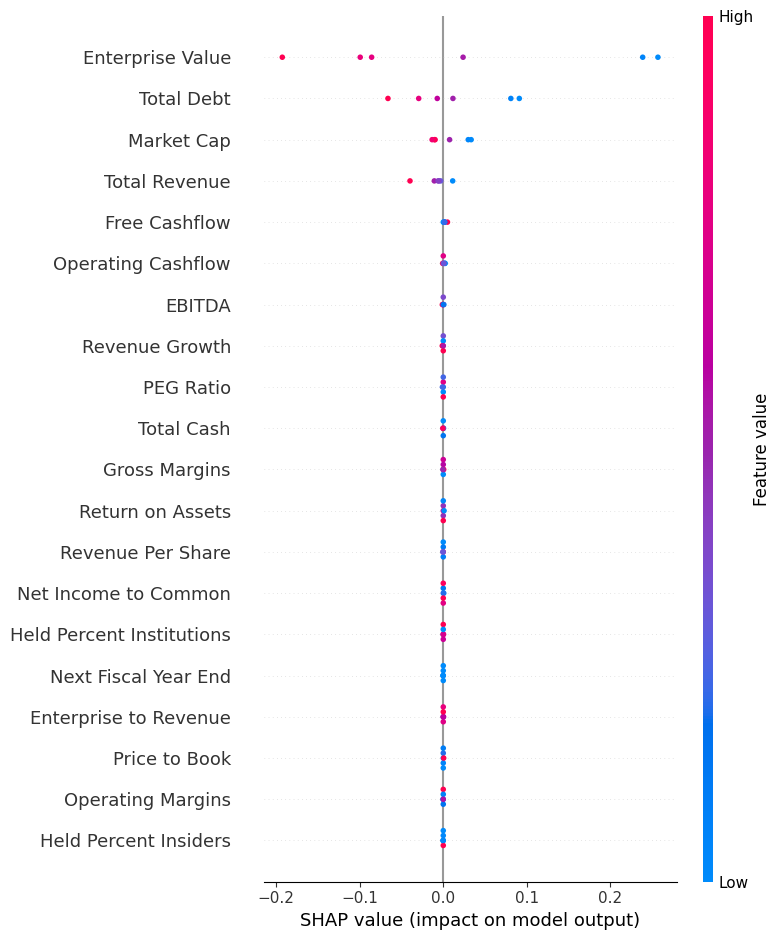

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


SVM Model LIME Analysis for Sector Consumer Defensive


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:200: LinAlgWarning: Ill-conditioned matrix (rcond=7.40013e-26): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.339e+02, tolerance: 1.037e-01
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Financial Services: Lasso with R² = 0.5503


  0%|          | 0/13 [00:00<?, ?it/s]


Lasso Model SHAP Analysis for Sector Financial Services


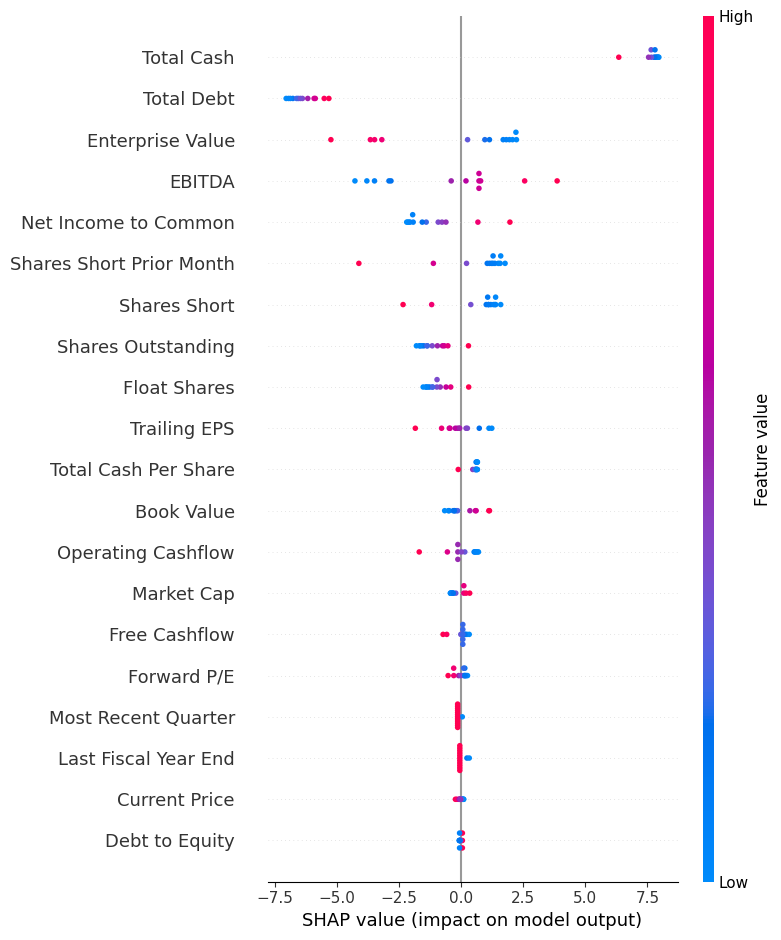

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


Lasso Model LIME Analysis for Sector Financial Services


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:239: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.151e-01, tolerance: 6.409e-02
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Utilities: SVM with R² = 0.1138


  0%|          | 0/4 [00:00<?, ?it/s]


SVM Model SHAP Analysis for Sector Utilities


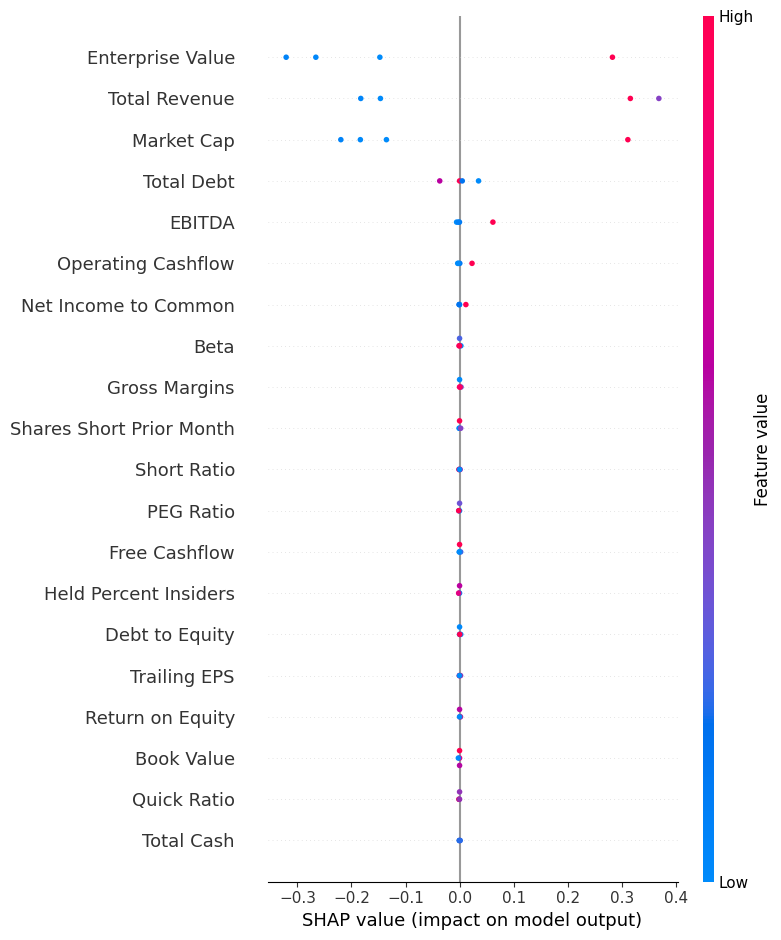

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


SVM Model LIME Analysis for Sector Utilities


/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:427: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:239: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.649e+00, tolerance: 1.494e-02
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Technology: SVM with R² = -0.2403


  0%|          | 0/6 [00:00<?, ?it/s]


SVM Model SHAP Analysis for Sector Technology


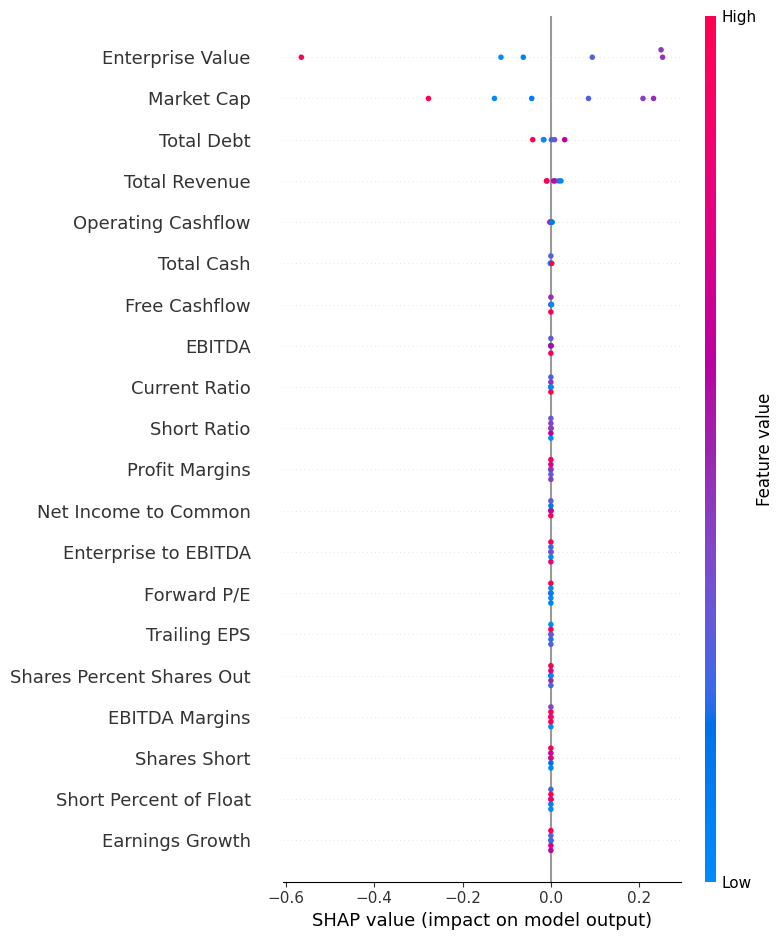

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


SVM Model LIME Analysis for Sector Technology


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:200: LinAlgWarning: Ill-conditioned matrix (rcond=2.60089e-26): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.589e+02, tolerance: 7.277e-02
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Communication Services: XGBoost with R² = 0.1989

XGBoost Model SHAP Analysis for Sector Communication Services


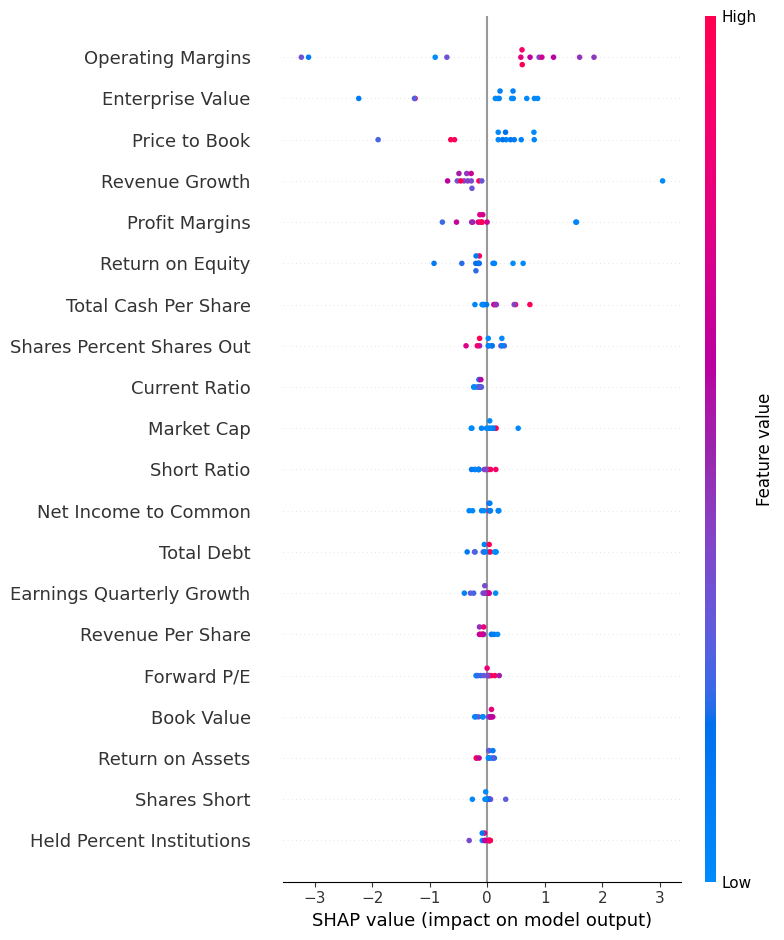

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


XGBoost Model LIME Analysis for Sector Communication Services


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:239: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.012e-01, tolerance: 2.943e-02
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Consumer Cyclical: XGBoost with R² = 0.0291

XGBoost Model SHAP Analysis for Sector Consumer Cyclical


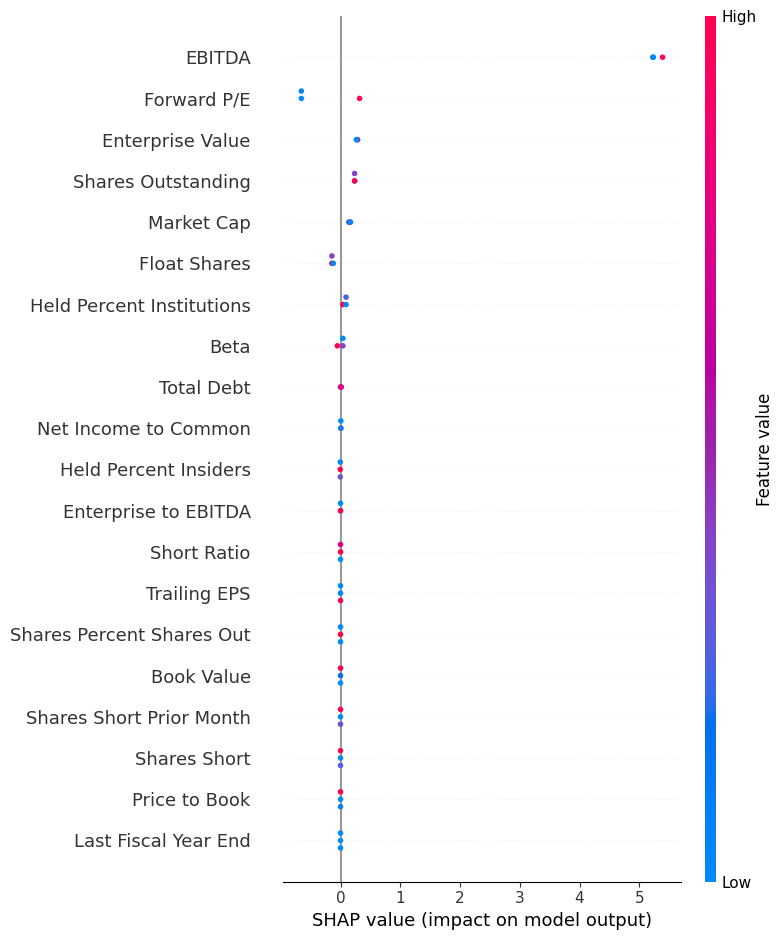

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


XGBoost Model LIME Analysis for Sector Consumer Cyclical


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_ridge.py:239: UserWarning: Singular matrix in solving dual problem. Using least-squares solution instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.800e+01, tolerance: 7.303e-02
  model = cd_fast.enet_coordinate_descent(



Best Model for Sector Industrials: RandomForest with R² = 0.1368

RandomForest Model SHAP Analysis for Sector Industrials


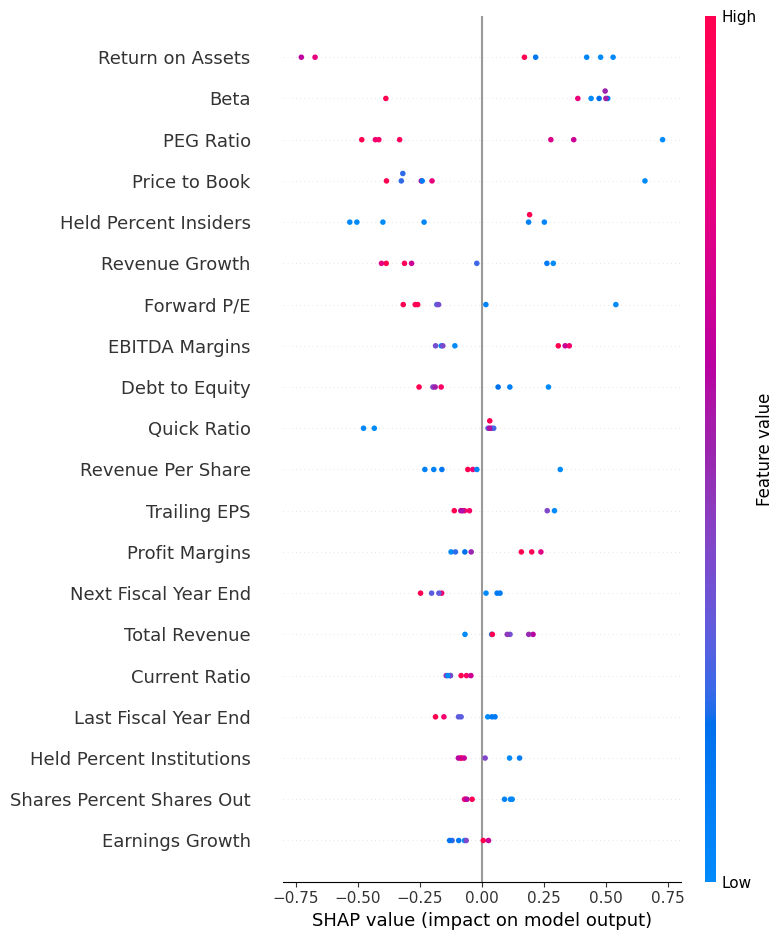

/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:544: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


RandomForest Model LIME Analysis for Sector Industrials


/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/discretize.py:110: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  ret[feature] = int(self.lambdas[feature](ret[feature]))
/usr/local/lib/python3.10/dist-packages/lime/lime_tabular.py:427: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.


Sector: 0.0 - Model Evaluation Metrics:

Model: Ridge
MSE: 251.6208
RMSE: 15.8626
MAE: 14.6877
R²: -5.1065

Model: Lasso
MSE: 3.1538
RMSE: 1.7759
MAE: 1.5183
R²: 0.9235

Model: GradientBoosting
MSE: 33.4477
RMSE: 5.7834
MAE: 5.2190
R²: 0.1883

Model: XGBoost
MSE: 41.4315
RMSE: 6.4367
MAE: 4.9098
R²: -0.0055

Model: SVM
MSE: 74.7403
RMSE: 8.6452
MAE: 6.1561
R²: -0.8138

Model: RandomForest
MSE: 44.3190
RMSE: 6.6573
MAE: 4.9261
R²: -0.0756

Sector: 2.0 - Model Evaluation Metrics:

Model: Ridge
MSE: 142.7487
RMSE: 11.9477
MAE: 8.9769
R²: -2.3603

Model: Lasso
MSE: 1910.9563
RMSE: 43.7145
MAE: 20.3904
R²: -43.9835

Model: GradientBoosting
MSE: 30.1316
RMSE: 5.4892
MAE: 4.6004
R²: 0.2907

Model: XGBoost
MSE: 23.8788
RMSE: 4.8866
MAE: 4.4462
R²: 0.4379

Model: SVM
MSE: 38.5399
RMSE: 6.2081
MAE: 5.1152
R²: 0.0928

Model: RandomForest
MSE: 41.8910
RMSE: 6.4723
MAE: 5.5713
R²: 0.0139

Sector: 6.0 - Model Evaluation Metrics:

Model: Ridge
MSE: 226.8607
RMSE: 15.0619
MAE: 9.3505
R²: -9.5237

Mod

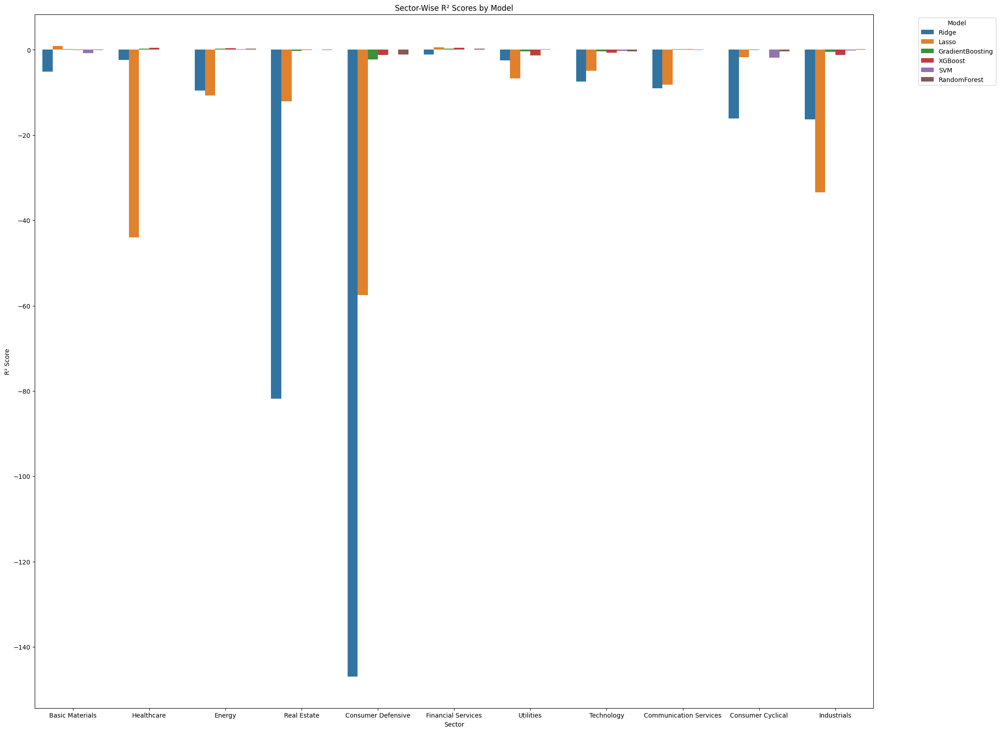

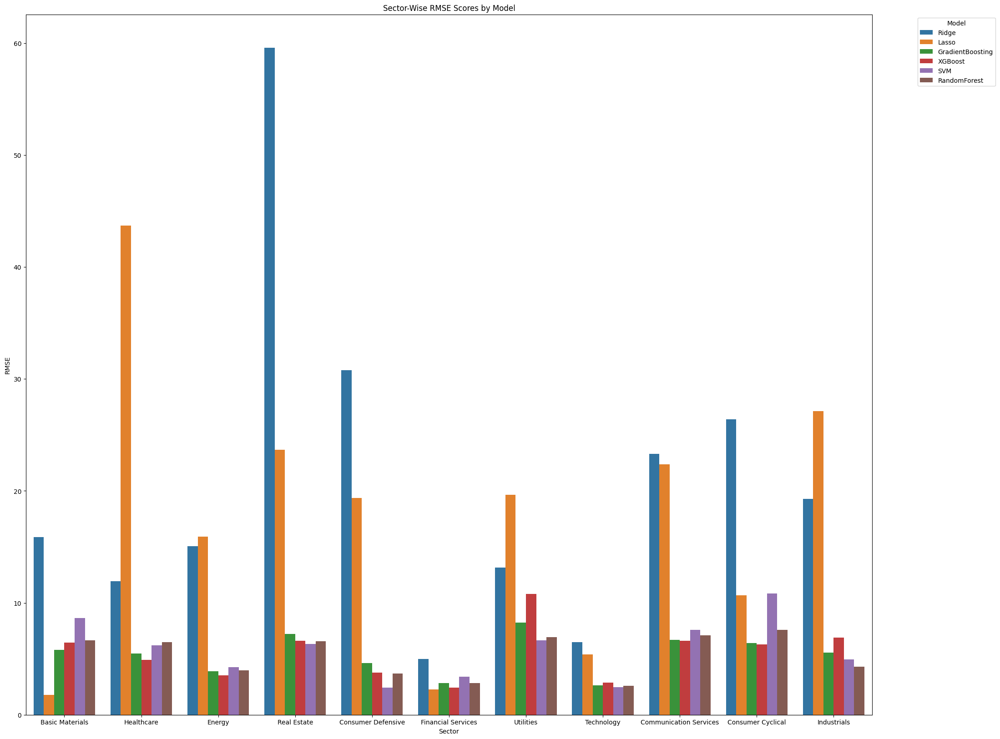

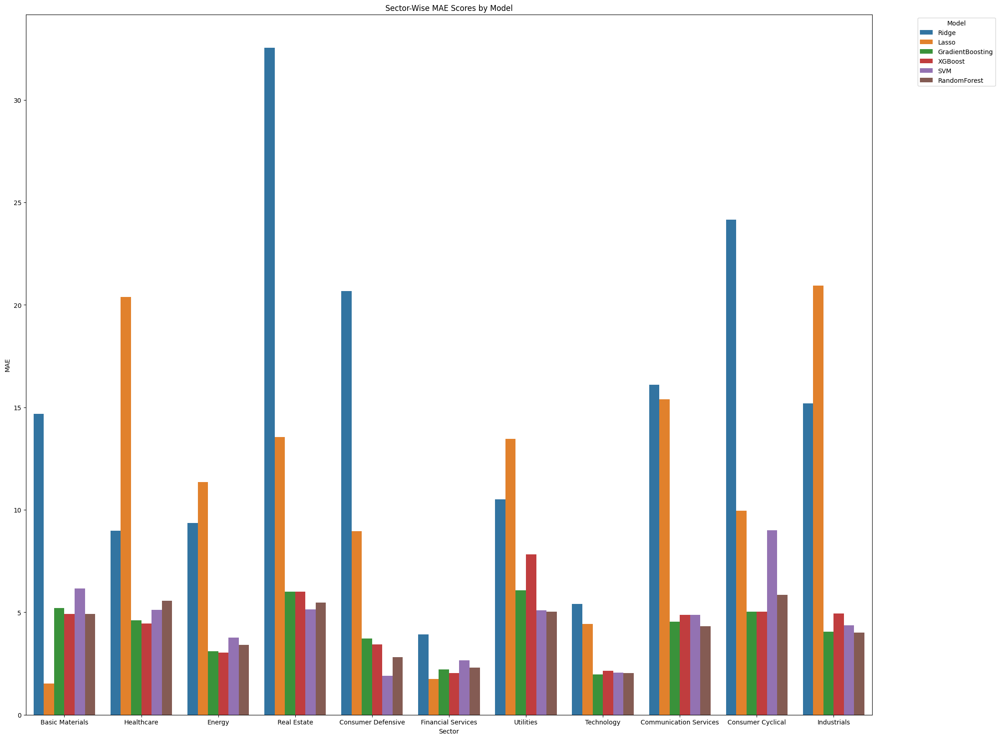

In [ ]:
for sector in sectors:
    X_sector = df_sector_imputed[df_sector_imputed['sector'] == sector].drop(columns=['total esg', 'sector'])
    y_sector = df_sector_imputed[df_sector_imputed['sector'] == sector]['total esg']

    X_train_sector, X_test_sector, y_train_sector, y_test_sector = train_test_split(X_sector, y_sector, test_size=0.2, random_state=42)

    sector_results[sector] = {}
    best_r2 = -np.inf  # Initialize best R² to a very low value
    best_model_name = None
    best_model = None

    for model_name, model in models.items():
        model.fit(X_train_sector, y_train_sector)
        y_pred_sector = model.predict(X_test_sector)

        mse_sector = mean_squared_error(y_test_sector, y_pred_sector)
        rmse_sector = np.sqrt(mse_sector)
        mae_sector = mean_absolute_error(y_test_sector, y_pred_sector)
        r2_sector = r2_score(y_test_sector, y_pred_sector)

        sector_results[sector][model_name] = {
            'MSE': mse_sector,
            'RMSE': rmse_sector,
            'MAE': mae_sector,
            'R²': r2_sector
        }

        # Check if this model has the best R² score
        if r2_sector > best_r2:
            best_r2 = r2_sector
            best_model_name = model_name
            best_model = model

    # SHAP Analysis for the best model
    print(f"\nBest Model for Sector {sector_mapping[sector]}: {best_model_name} with R² = {best_r2:.4f}")

    if best_model_name in ['GradientBoosting', 'XGBoost', 'RandomForest']:
        explainer = shap.TreeExplainer(best_model)
    else:
        explainer = shap.KernelExplainer(best_model.predict, X_train_sector)

    shap_values = explainer.shap_values(X_test_sector)
    print(f"\n{best_model_name} Model SHAP Analysis for Sector {sector_mapping[sector]}")
    shap.summary_plot(shap_values, X_test_sector, feature_names=X_test_sector.columns)

    # LIME Analysis for the best model
    lime_explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=np.array(X_train_sector),
        feature_names=X_train_sector.columns,
        class_names=['ESG Score'],
        mode='regression'
    )

    i = np.random.randint(0, X_test_sector.shape[0])
    instance = X_test_sector.iloc[i]
    lime_exp = lime_explainer.explain_instance(data_row=instance, predict_fn=best_model.predict)
    print(f"\n{best_model_name} Model LIME Analysis for Sector {sector_mapping[sector]}")
    lime_exp.show_in_notebook(show_table=True)

# Display sector-wise results
for sector, models in sector_results.items():
    print(f"\nSector: {sector} - Model Evaluation Metrics:")
    for model_name, metrics in models.items():
        print(f"\nModel: {model_name}")
        for metric_name, value in metrics.items():
            print(f"{metric_name}: {value:.4f}")

# Convert the sector results into a DataFrame for easier visualization
all_results = []
for sector, models in sector_results.items():
    for model_name, metrics in models.items():
        all_results.append([sector, model_name, metrics['R²'], metrics['RMSE'], metrics['MAE']])

sector_results_df = pd.DataFrame(all_results, columns=['Sector', 'Model', 'R²', 'RMSE', 'MAE'])

sector_results_df['Sector Name'] = sector_results_df['Sector'].map(sector_mapping)

# Plot the results
plt.figure(figsize=(24, 20))
sns.barplot(x='Sector Name', y='R²', hue='Model', data=sector_results_df)
plt.title('Sector-Wise R² Scores by Model')
plt.xlabel('Sector')
plt.ylabel('R² Score')
plt.legend(title='Model', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

plt.figure(figsize=(24, 20))
sns.barplot(x='Sector Name', y='RMSE', hue='Model', data=sector_results_df)
plt.title('Sector-Wise RMSE Scores by Model')
plt.xlabel('Sector')
plt.ylabel('RMSE')
plt.legend(title='Model', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

plt.figure(figsize=(24, 20))
sns.barplot(x='Sector Name', y='MAE', hue='Model', data=sector_results_df)
plt.title('Sector-Wise MAE Scores by Model')
plt.xlabel('Sector')
plt.ylabel('MAE')
plt.legend(title='Model', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()